## init


In [1]:
#from google.colab import drive 
#drive.mount('/content/gdrive') # 將 google drive 掛載在 colob

In [2]:
#%cd '/content/gdrive/MyDrive/'
#!ls

In [3]:
#!pip install fastText

In [4]:
#!pip install jovian --upgrade

In [5]:
#!pip install nmslib

In [6]:
from pathlib import Path
import os
import pickle
import shutil
import json,re
import pandas as pd
import numpy as np
import random
from PIL import Image
import torchvision.models as models
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
from torch.utils.data import Dataset, DataLoader
import torch.nn.functional as F
import torch
from torch import nn
from torchvision.utils import make_grid
from tqdm.notebook import tqdm
import fasttext as ft
from gensim.models import FastText
%matplotlib inline

## Setting

In [7]:
resnet_path=".\model\my_RES_ag_2.pth"
RetrainedResNet = False
load_path='./AWA2_33c/test/'
out_dim=200  #Word2Vec維度(Encoder的輸出維度。)

'''下三行:吃圖片的路徑'''    
train_path=Path("./data/AWA2/IMG_backoff/train")
test_path=Path("./data/AWA2/IMG_backoff/test")
val_path=Path("./data/AWA2/IMG_backoff/val")

### Gensim pretrain MODEL
實驗用到的以下Word2Vec:
* 100-d:'glove-twitter-100'--v1  ; glove-wiki-gigaword-100 --v2
* 200-d:'glove-wiki-gigaword-200'
* 300-d:word2vec-google-news-300 ；fasttext-wiki-news-subwords-300

In [8]:
import gensim.downloader
from gensim.models import KeyedVectors

In [9]:
glove_vectors = gensim.downloader.load('glove-wiki-gigaword-200') 
#glove-wiki-gigaword-200   #'glove-twitter-200'
#glove-wiki-gigaword-100   #glove-twitter-100'
#word2vec-google-news-300  #fasttext-wiki-news-subwords-300  #'glove-wiki-gigaword-300'
#glove-wiki-gigaword-50    #glove-twitter-50

## DataSet

In [10]:
train_classes = []
train_images = []
train_img_vecs = []
test_classes=[]
test_images = []
test_img_vecs = []
train_class_labels=[]
val_class_labels=[]
test_class_labels=[]

In [11]:
val_classes = []
val_images = []
val_img_vecs = []

In [12]:
train_images=np.load(load_path+'train_img_name.npy',allow_pickle=True)
train_img_vecs=np.load(load_path+'train_img_vec.npy',allow_pickle=True)
train_classes=np.load(load_path+'train_class.npy',allow_pickle=True)
val_images=np.load(load_path+'val_img_name.npy',allow_pickle=True)
val_img_vecs=np.load(load_path+'val_img_vec.npy',allow_pickle=True)
val_classes=np.load(load_path+'val_img_class.npy',allow_pickle=True)
test_images=np.load(load_path+'test_img_name.npy',allow_pickle=True)
test_img_vecs=np.load(load_path+'test_img_vec.npy',allow_pickle=True)
test_classes=np.load(load_path+'test_img_class.npy',allow_pickle=True)
train_class_labels=np.load(load_path+'train_img_label.npy',allow_pickle=True)
val_class_labels=np.load(load_path+'val_img_label.npy',allow_pickle=True)
test_class_labels=np.load(load_path+'test_img_label.npy',allow_pickle=True)

### Train Data

#### Check

In [13]:
print(len(train_classes))
print(len(train_images))
print(len(train_img_vecs))
print(len(train_class_labels))
print((train_class_labels))

33
21057
21057
21057
[13 13 12 ... 17 16 17]


In [14]:
train_img_vecs = np.stack(train_img_vecs)
print(train_img_vecs.shape)

(21057, 200)


In [15]:
grouped = list(zip(train_images, train_img_vecs,train_class_labels)) 
random.shuffle(grouped) 
train_images, train_img_vecs,train_class_labels = zip(*grouped)

### Test Data

#### Check

In [16]:
print(len(test_classes))
print(len(test_images))
print(len(test_img_vecs))
print(test_classes)
print(len(test_class_labels))

7
4654
4654
['chimpanzee' 'hippopotamus' 'leopard' 'pig' 'raccoon' 'rat' 'seal']
4654


In [17]:
test_img_vecs  = np.stack(test_img_vecs)
print(test_img_vecs.shape)

(4654, 200)


### Val_Data

#### Check

In [18]:
print(len(val_classes))
print(len(val_images))
print(len(val_img_vecs))
print(val_classes)
#print(train_classes)
print(len(val_class_labels))

33
5268
5268
['antelope' 'bat' 'beaver' 'bobcat' 'buffalo' 'chihuahua' 'collie' 'cow'
 'dalmatian' 'deer' 'dolphin' 'elephant' 'fox' 'giraffe' 'gorilla'
 'hamster' 'horse' 'lion' 'mole' 'moose' 'mouse' 'otter' 'ox' 'rabbit'
 'rhinoceros' 'sheep' 'skunk' 'squirrel' 'tiger' 'walrus' 'weasel' 'wolf'
 'zebra']
5268


In [19]:
val_img_vecs  = np.stack(val_img_vecs)
print(val_img_vecs.shape)

(5268, 200)


In [20]:
grouped_val = list(zip(val_images, val_img_vecs,val_class_labels)) 
random.shuffle(grouped_val) 
val_images, val_img_vecs,val_class_labels= zip(*grouped_val)

## Transform

In [21]:
class Dataset(Dataset):
    #def __init__(self, images, vecs,labels, transform=None):#(self, images, vecs,labels, transform=None):
    def __init__(self, images, vecs, transform=None):
        self.images = images
        self.vecs = vecs
        self.transform = transform
        #self.labels=labels
    def __len__(self):
        return len(self.images)    
    
    def __getitem__(self, idx):
        img_path = self.images[idx]
        img_vec = self.vecs[idx]
        #label = self.labels[idx]
        #img_class = self.labels[idx]
        img = Image.open(img_path).convert("RGB")
        if self.transform:
            img = self.transform(img)
        return img, img_vec #,label

In [22]:
transform  = transforms.Compose([transforms.Resize(size=(200,200)),
                                 transforms.ToTensor(),
                                 transforms.Normalize(mean=[0.485, 0.456, 0.406],std=[0.229, 0.224, 0.225])])
'''
train_dataset = Dataset(train_images,train_img_vecs,train_class_labels,transform)
val_dataset = Dataset(val_images,val_img_vecs,val_class_labels,transform)
test_dataset = Dataset(test_images,test_img_vecs,test_class_labels,transform)
'''
train_dataset = Dataset(train_images,train_img_vecs,transform)
val_dataset = Dataset(val_images,val_img_vecs,transform)
test_dataset = Dataset(test_images,test_img_vecs,transform)

In [23]:
def denorm(img,mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]):
    return img*torch.Tensor(std).unsqueeze(1).unsqueeze(1)+torch.Tensor(mean).unsqueeze(1).unsqueeze(1)
def show_sample(img, target, invert=True):
    img = denorm(img).clamp(0,1)
    if invert:
        plt.imshow(1 - img.permute((1, 2, 0)))
    else:
        plt.imshow(img.permute(1, 2, 0))

In [24]:
print(val_images)

(WindowsPath('data/AWA2/IMG_backoff/val/horse/horse_11040.jpg'), WindowsPath('data/AWA2/IMG_backoff/val/cow/cow_10076.jpg'), WindowsPath('data/AWA2/IMG_backoff/val/ox/ox_10359.jpg'), WindowsPath('data/AWA2/IMG_backoff/val/hamster/hamster_10287.jpg'), WindowsPath('data/AWA2/IMG_backoff/val/fox/fox_10182.jpg'), WindowsPath('data/AWA2/IMG_backoff/val/ox/ox_10378.jpg'), WindowsPath('data/AWA2/IMG_backoff/val/lion/lion_10429.jpg'), WindowsPath('data/AWA2/IMG_backoff/val/squirrel/squirrel_10103.jpg'), WindowsPath('data/AWA2/IMG_backoff/val/sheep/sheep_10226.jpg'), WindowsPath('data/AWA2/IMG_backoff/val/cow/cow_10194.jpg'), WindowsPath('data/AWA2/IMG_backoff/val/beaver/beaver_10080.jpg'), WindowsPath('data/AWA2/IMG_backoff/val/cow/cow_11052.jpg'), WindowsPath('data/AWA2/IMG_backoff/val/buffalo/buffalo_10485.jpg'), WindowsPath('data/AWA2/IMG_backoff/val/skunk/skunk_10075.jpg'), WindowsPath('data/AWA2/IMG_backoff/val/antelope/antelope_11002.jpg'), WindowsPath('data/AWA2/IMG_backoff/val/zebra/ze

'圖片的資料集要放該目錄下。交接沒有提供AWA2圖片。'

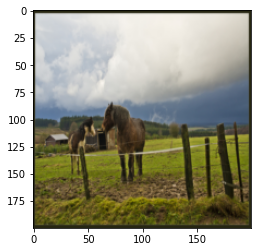

In [25]:
show_sample(*val_dataset[0], invert=False) 
'''圖片的資料集要放該目錄下。交接沒有提供AWA2圖片。'''

## Batch

In [26]:
def show_batch(dl):
    for images, vecs in dl:
        fig, ax = plt.subplots(figsize=(16, 8))
        ax.set_xticks([]); ax.set_yticks([])
        data = denorm(images).clamp(0,1)
        ax.imshow(make_grid(data, nrow=16).permute(1, 2, 0))
        break

In [27]:
IsShuffle = False

In [28]:
if (IsShuffle):
  batch_size=64
  train_dl = DataLoader(train_dataset, batch_size, shuffle=True, drop_last=True,num_workers=0, pin_memory=True)
  val_dl = DataLoader(val_dataset, batch_size, shuffle=False, drop_last=True,num_workers=0, pin_memory=True)
  test_dl = DataLoader(test_dataset, batch_size*2, shuffle=False,drop_last=True, num_workers=0, pin_memory=True)
else:#using to Testing(not shuffle)
  batch_size=64
  train_dl = DataLoader(train_dataset, batch_size, shuffle=False, drop_last=False,num_workers=0, pin_memory=True)
  val_dl = DataLoader(val_dataset, batch_size, shuffle=False, drop_last=False,num_workers=0, pin_memory=True)
  test_dl = DataLoader(test_dataset, batch_size*2, shuffle=False,drop_last=False, num_workers=0, pin_memory=True)

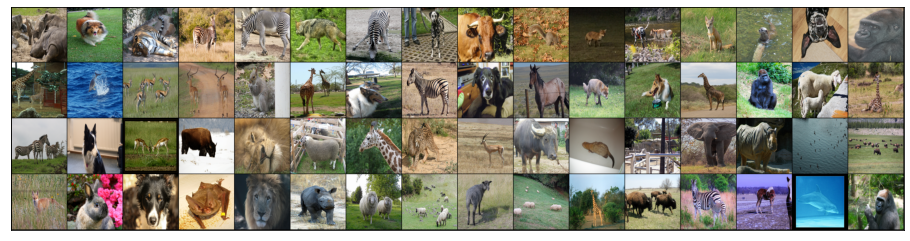

In [29]:
show_batch(train_dl)

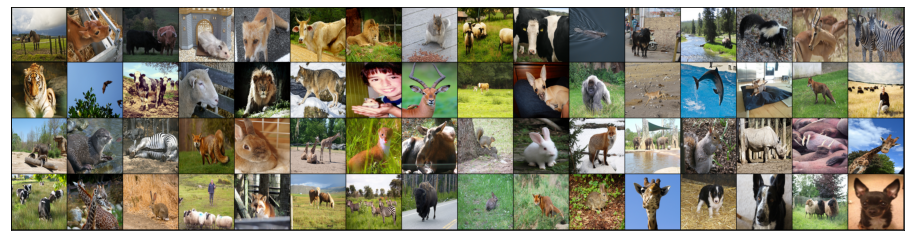

In [30]:
show_batch(val_dl)

## Model

In [31]:
class TrainerBase(nn.Module):
    def training_step(self, batch):
        images, targets= batch
        out = self(images)
        mse_loss = nn.MSELoss()
        loss = mse_loss(out,targets)
        #loss = 1 - F.cosine_similarity(out,targets).mean()
        return loss
    
    def validation_step(self, batch):
        images, targets= batch 
        out = self(images)
        mse_loss = nn.MSELoss()
        loss = mse_loss(out,targets)
        #loss = 1 - F.cosine_similarity(out,targets).mean()
        return {'val_loss': loss.detach()}
        
    def validation_epoch_end(self, outputs):
        batch_losses = [x['val_loss'] for x in outputs]
        epoch_loss = torch.stack(batch_losses).mean()   # Combine losses
        return {'val_loss': epoch_loss.item()}
    
    def epoch_end(self, epoch, result):
        print("Epoch [{}], train_loss: {:.4f}, val_loss: {:.4f}".format(
            epoch, result['train_loss'], result['val_loss']))

In [32]:
class AdaptiveConcatPool2d(nn.Module):
    def __init__(self, sz=1):
        super().__init__()
        self.adavgp = nn.AdaptiveAvgPool2d(sz)
        self.adamaxp = nn.AdaptiveMaxPool2d(sz)
    def forward(self, x):
        x = torch.cat([self.adavgp(x), self.adamaxp(x)], 1)
        x = x.view(x.size(0),-1)
        return x

### Not Retarined ResNet

In [33]:
class AttriGenModel(TrainerBase):
    def __init__(self):
        super().__init__()
        # Use a pretrained model
        #model.load_state_dict(torch.load(model_path))
        self.network = models.resnet101(pretrained=True)
        #self.network = self.load_state_dict(torch.load(resnet_path))
        # Replace last layer
        num_ftrs = self.network.fc.in_features
        self.network.fc = nn.Sequential(nn.Flatten(),
                                       nn.Dropout(p=0.3),
                                       nn.Linear(in_features=num_ftrs,out_features=num_ftrs//2),
                                       nn.ReLU(inplace=True),
                                       nn.BatchNorm1d(num_ftrs//2),
                                       nn.Dropout(p=0.3),
                                       nn.Linear(in_features=num_ftrs//2,out_features=num_ftrs//4),
                                       nn.ReLU(inplace=True),
                                       nn.BatchNorm1d(num_ftrs//4),
                                       nn.Dropout(p=0.3), 
                                       nn.Linear(num_ftrs//4,out_dim))  
    def forward(self, xb):
        return self.network(xb)

### Retrained ResNet

In [34]:
res101=models.resnet101(pretrained=True)

In [35]:
class resnet_retrained_model(TrainerBase):
    def __init__(self):
        super(resnet_retrained_model, self).__init__()
        self.network=models.resnet101(pretrained=True)
        self.network.fc = nn.Sequential(
                           nn.Linear(2048, 1024),
                           nn.ReLU(inplace=True),
                           nn.Linear(1024,40),
                           nn.Softmax(dim=0)
                            )
    def forward(self, x):
        return self.network(x)
###############################################################################
#                            END TODO                                         #
###############################################################################
x = torch.randn(4, 3, 224, 224)
resnet_retrained_model = resnet_retrained_model()
#make_dot(mymodel(x), params=dict(model.named_parameters()))

In [36]:
resnet_retrained_model.load_state_dict(torch.load(resnet_path))
resnet_retrained_model.eval()
class AttriGenModel_RetrainVer(TrainerBase):
    def __init__(self):
        super(AttriGenModel_RetrainVer, self).__init__()
        self.Net=resnet_retrained_model
        num_ftrs = self.Net.network.fc[0].in_features
        self.Net.network.fc = nn.Sequential(nn.Flatten(),
                                       nn.Dropout(p=0.3),
                                       nn.Linear(in_features=num_ftrs,out_features=num_ftrs//2),
                                       nn.ReLU(inplace=True),
                                       nn.BatchNorm1d(num_ftrs//2),
                                       nn.Dropout(p=0.3),
                                       nn.Linear(in_features=num_ftrs//2,out_features=num_ftrs//4),
                                       nn.ReLU(inplace=True),
                                       nn.BatchNorm1d(num_ftrs//4),
                                       nn.Dropout(p=0.3), 
                                       nn.Linear(num_ftrs//4,out_dim))
    def forward(self, x):
        return self.Net(x)
###############################################################################
#                            END TODO                                         #
###############################################################################
#make_dot(mymodel(x), params=dict(model.named_parameters()))

In [37]:
def get_default_device():
    """Pick GPU if available, else CPU"""
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')
    
def to_device(data, device):
    """Move tensor(s) to chosen device"""
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    """Wrap a dataloader to move data to a device"""
    def __init__(self, dl, device):
        self.dl = dl
        self.device = device
        
    def __iter__(self):
        """Yield a batch of data after moving it to device"""
        for b in self.dl: 
            yield to_device(b, self.device)

    def __len__(self):
        """Number of batches"""
        return len(self.dl)

In [38]:
#import torch
#print(torch.__version__)

In [39]:
device = get_default_device()
print(device)

cuda


In [40]:
#torch.cuda.is_available()

In [41]:
#!nvidia-smi

In [42]:
train_dl = DeviceDataLoader(train_dl, device)
val_dl = DeviceDataLoader(val_dl, device)
test_dl = DeviceDataLoader(test_dl, device)


In [43]:
if(RetrainedResNet):
  model = to_device(AttriGenModel_RetrainVer(), device)
else:
  model = to_device(AttriGenModel(), device)
#RetrainedResNet 架構上有點差別。(我個人平常都是用Retrained_ver)

In [44]:
print(model)

AttriGenModel(
  (network): ResNet(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
    

In [45]:
def evaluate(model, val_loader):
    model.eval()
    outputs = [model.validation_step(batch) for batch in val_loader]
    return model.validation_epoch_end(outputs)

def fit(epochs, lr, model, train_loader, val_loader, opt_func):
    torch.cuda.empty_cache()
    history = []
    optimizer = opt_func(model.parameters(), lr)
    for epoch in range(epochs):
        # Training Phase 
        model.train()
        train_losses = []
        for batch in tqdm(train_loader):
            loss = model.training_step(batch)
            train_losses.append(loss)
            loss.backward()
            optimizer.step()
            optimizer.zero_grad()
        # Validation phase
        result = evaluate(model, val_loader)
        result['train_loss'] = torch.stack(train_losses).mean().item()
        model.epoch_end(epoch, result)
        history.append(result)
    return history

In [46]:
for param in list(model.parameters()):
    param.requires_grad = True
for param in list(model.parameters())[:-8]:
    param.requires_grad = False

In [47]:
num_epochs = 1
opt_func = torch.optim.Adam
lr = 3e-3

In [48]:
history = fit(num_epochs, lr, model, train_dl, val_dl, opt_func)
#train_dl會有330，由於是測試code成功一口氣跑，所以我這裡採用val(83 run)

  0%|          | 0/83 [00:00<?, ?it/s]

Epoch [0], train_loss: 0.1871, val_loss: 0.0512


### Save Model&Loss

In [49]:
torch.save(model.state_dict(),"./model/test.pth")

In [50]:
history 

[{'val_loss': 0.05120518058538437, 'train_loss': 0.18713216483592987}]

## Evalation & Predict

### Model Load:

In [51]:
model_path=Path("./model/test.pth")
model.load_state_dict(torch.load(model_path))
#model = torch.load(model_path)
opt_func = torch.optim.Adam
lr = 3e-3
optimizer = opt_func(model.parameters(), lr)
#optimizer = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)

In [52]:
def predict_dl_batch(dl, model):
    torch.cuda.empty_cache()
    batch_probs = []
    model.eval()
    for xb, _ in tqdm(dl):
        pred_wv = model(xb.cuda())
        batch_probs.append(pred_wv.cpu().detach())
    batch_probs = torch.cat(batch_probs)
    return batch_probs.numpy()

### Val_attribute

In [53]:
try:
    pred_val=np.load(load_path+'val_attr.npy',allow_pickle=True)
except IOError:
    pred_val = predict_dl_batch(val_dl,model)
    np.save(load_path+'val_attr.npy', pred_val)

  0%|          | 0/83 [00:00<?, ?it/s]

In [54]:
#print(pred_val[0])
#dataset[0](第幾張圖)[0](img的RGB)，dataset[0](第幾張圖)[1](img的word Vec)
#print((val_dataset[0][0]))
#print((val_dataset[0][1]))
#print((val_img_vecs[0]))

In [55]:
'''
import math
sum=0
for k in range(len(val_img_vecs[0])):
    sum=sum+pow(pred_val[3][k]-val_img_vecs[3][k],2)
print(math.sqrt(sum))
'''

'\nimport math\nsum=0\nfor k in range(len(val_img_vecs[0])):\n    sum=sum+pow(pred_val[3][k]-val_img_vecs[3][k],2)\nprint(math.sqrt(sum))\n'

### Train_attribute

In [56]:
try:
    pred_train=np.load(load_path+'train_attr.npy',allow_pickle=True)
except IOError:
    pred_train = predict_dl_batch(train_dl,model)
    np.save(load_path+'train_attr.npy', pred_train)

In [57]:
print(pred_train.shape)

(21057, 200)


In [58]:
'''
for m in range(33):
    sum=0
    for k in range(len(train_img_vecs[m])):
        sum=sum+pow(pred_train[m][k]-train_img_vecs[m][k],2)
    print(math.sqrt(sum))
'''

'\nfor m in range(33):\n    sum=0\n    for k in range(len(train_img_vecs[m])):\n        sum=sum+pow(pred_train[m][k]-train_img_vecs[m][k],2)\n    print(math.sqrt(sum))\n'

### Test Attribute

In [59]:
try:
    pred_test=np.load(load_path+'test_attr.npy',allow_pickle=True)
except IOError:
    pred_test = predict_dl_batch(test_dl,model)
    np.save(load_path+'test_attr.npy', pred_test)  

  0%|          | 0/37 [00:00<?, ?it/s]

In [60]:
print(pred_test.shape)

(4654, 200)


### 實驗:img與Word Vector轉換

In [61]:
import nmslib     #類似於KNN作法，Gensim中推薦測試使用的， 可google搜尋"nmslib"

def create_index(a):
    index = nmslib.init(space='angulardist')
    index.addDataPointBatch(a)
    index.createIndex()
    return index

def get_knns(index, vecs):
     return zip(*index.knnQueryBatch(vecs, k=1, num_threads=4))

def get_knn(index, vec): return index.knnQuery(vec, k=25)

#### show圖

In [62]:
def show_preds(idxs,dset="valid"):
    if dset == "valid":
        dataset = val_dataset
        images = val_images
    elif dset == "test":
        dataset = test_dataset
        images = test_images
    elif dset == "mix":
        dataset = datasets
        images = Images
    elif dset == "train":
        dataset=train_dataset
        images=train_images
        
    fig, axes = plt.subplots(nrows=5, ncols=5, figsize=(8,8))
    for ax,img_idx in zip(axes.flatten(),idxs[:25]):
        p=Path(images[img_idx])
        data = denorm(dataset[img_idx][0]).clamp(0,1)
        data = data.permute(1,2,0).numpy()
        ax.imshow(data)
        title = p.parent.name.rpartition(".")[-1]   ###可抓到label !!!!
        ax.set_title(title)
        ax.axis("off")
    return images[idxs[0]].parent.name.rpartition(".")[-1]

### Seen(Val_data)

In [63]:
nn_predwv = create_index(pred_val)

[0.8237611  0.82414067 0.831838   0.8394236  0.8397938  0.8443947
 0.84689754 0.8543898  0.8603337  0.8620736  0.8642101  0.8668515
 0.87178504 0.8734082  0.8749767  0.8759151  0.8769595  0.877114
 0.88104886 0.88185894 0.8831607  0.8853686  0.8880048  0.8903588
 0.89207137]


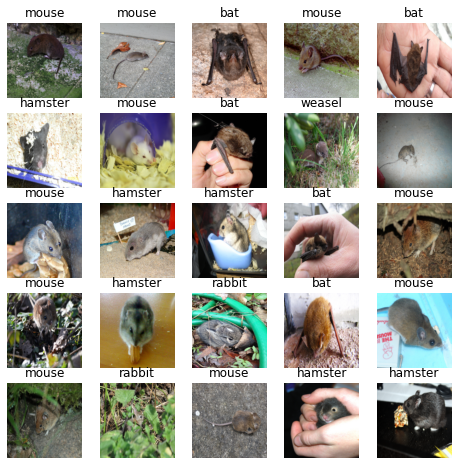

In [64]:
#給"Word"，轉成WordVector後從model中的資料找最相關。
vec =glove_vectors.get_vector('mouse')
idxs,dists = get_knn(nn_predwv, vec)
name = show_preds(idxs)
print(dists)

## Image reverse search

#### 輸入圖片，給top5個Word

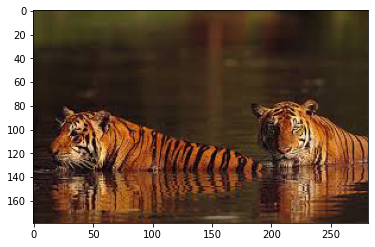

In [65]:
img=Image.open("./tiger4.jpg")
plt.imshow(img)

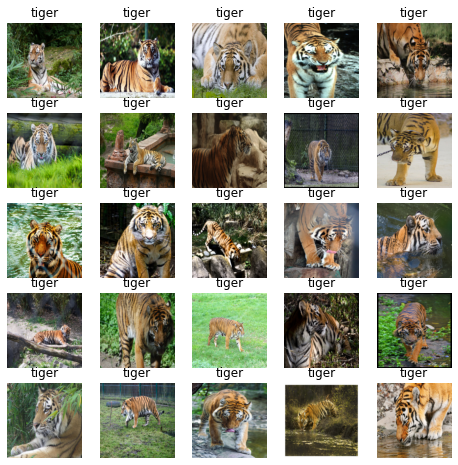

In [66]:
img=img.resize(size=(200,200))
pred_img=model(transform(img).unsqueeze(0).cuda())
idxs,dists = get_knn(nn_predwv, pred_img.cpu().detach().numpy())
names=show_preds(idxs)

In [67]:
names

'tiger'

In [68]:
glove_vectors.most_similar(names,topn=5)

[('tigers', 0.6394124627113342),
 ('woods', 0.5961560606956482),
 ('mickelson', 0.5454030632972717),
 ('elephant', 0.5280882716178894),
 ('tamil', 0.5262119770050049)]

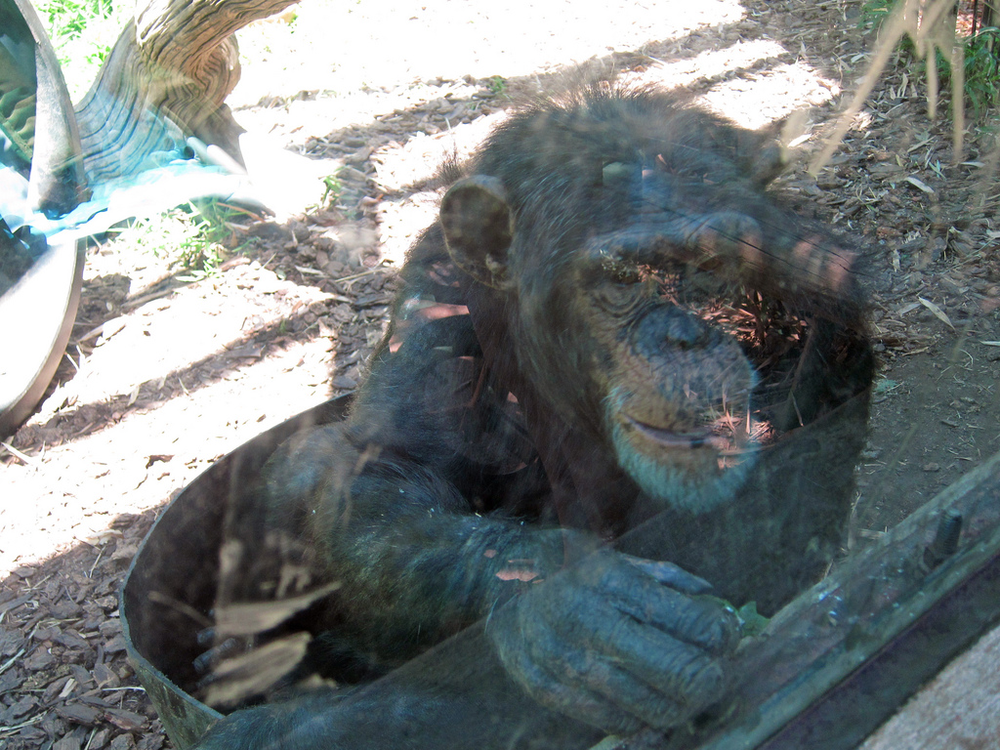

In [69]:
img=Image.open("./chimpanzee_10003.jpg")
img

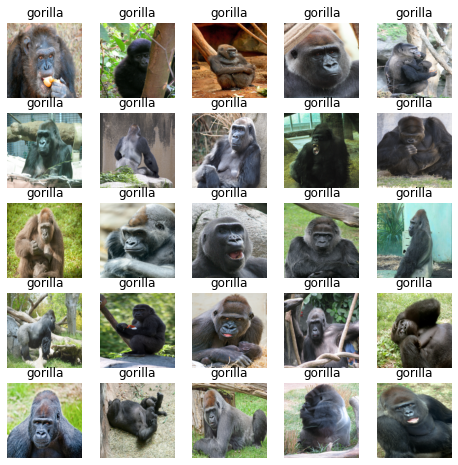

In [70]:
img=img.resize(size=(200,200))
pred_img=model(transform(img).unsqueeze(0).cuda())
idxs,dists = get_knn(nn_predwv, pred_img.cpu().detach().numpy())
names=show_preds(idxs)

In [71]:
l=[]
l=glove_vectors.most_similar(names,topn=5)
recommend= []
recommend.append(glove_vectors.most_similar(l[0][0],topn=5))

In [72]:
recommend

[[('900-pound', 0.6756784915924072),
  ('gorilla', 0.6485723257064819),
  ('600-pound', 0.5116898417472839),
  ('400-pound', 0.5073153376579285),
  ('gorillas', 0.49127697944641113)]]

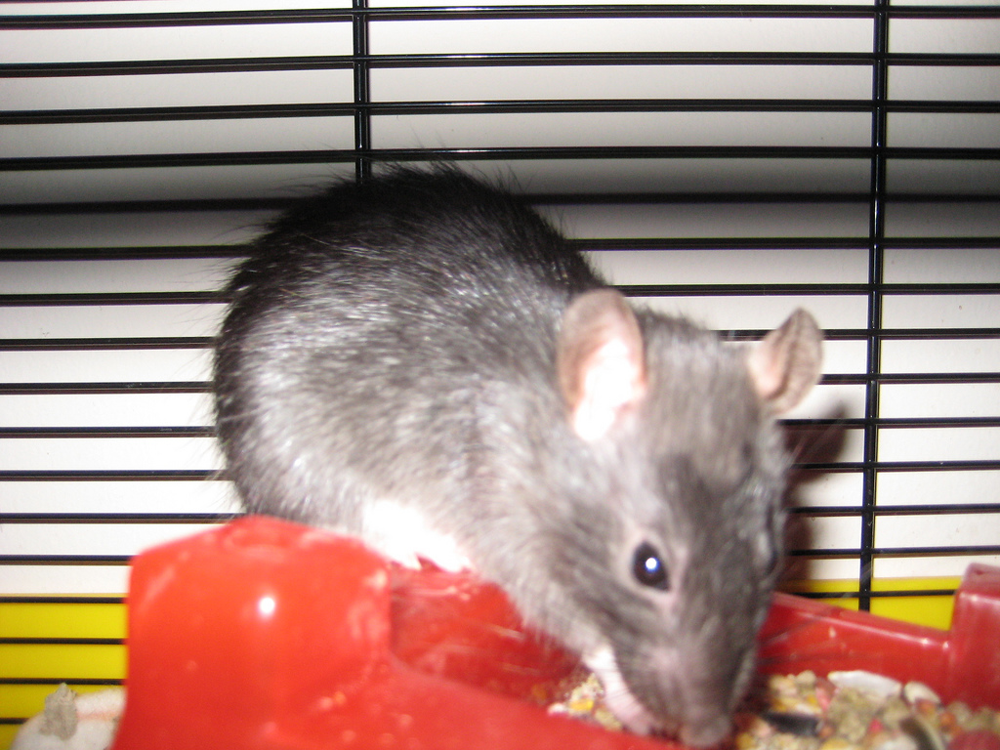

In [73]:
img=Image.open("./rat.jpg")
img

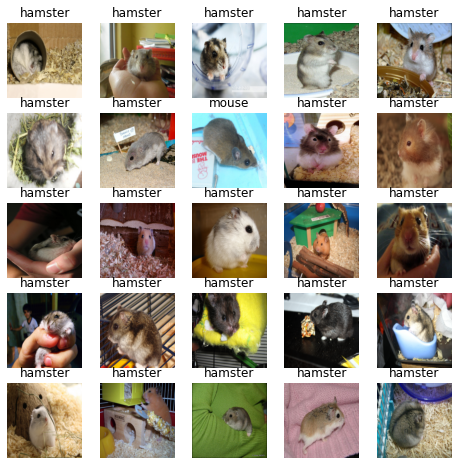

In [74]:
img=img.resize(size=(200,200))
pred_img=model(transform(img).unsqueeze(0).cuda())
idxs,dists = get_knn(nn_predwv, pred_img.cpu().detach().numpy())
names=show_preds(idxs)

In [75]:
l=[]
l=glove_vectors.most_similar(names,topn=5)
recommend= []
recommend.append(glove_vectors.most_similar(l[0][0],topn=5))

In [76]:
recommend

[[('gerbils', 0.7242090106010437),
  ('hamster', 0.5704230070114136),
  ('rabbits', 0.5671870112419128),
  ('chinchillas', 0.5570950508117676),
  ('ferrets', 0.5347434878349304)]]

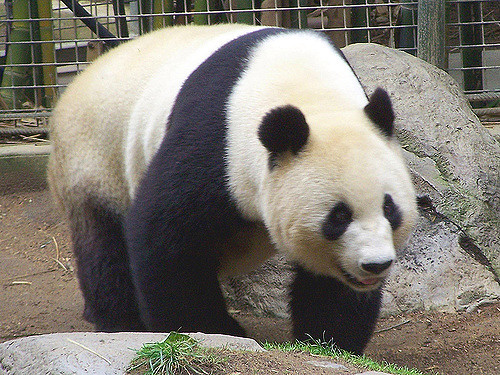

In [77]:
img=Image.open("./giant_panda.jpg")
img

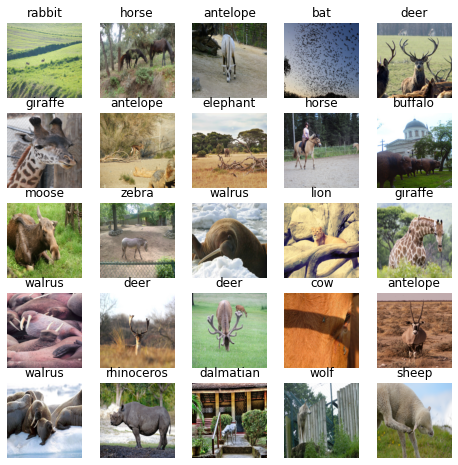

In [78]:
img=img.resize(size=(200,200))
pred_img=model(transform(img).unsqueeze(0).cuda())
idxs,dists = get_knn(nn_predwv, pred_img.cpu().detach().numpy())
names=show_preds(idxs)

In [79]:
l=[]
l=glove_vectors.most_similar(names,topn=5)
recommend= []
recommend.append(glove_vectors.most_similar(l[0][0],topn=5))

In [80]:
recommend

[[('squirrels', 0.736082911491394),
  ('raccoons', 0.7030894756317139),
  ('rodents', 0.6934987306594849),
  ('foxes', 0.6846523284912109),
  ('goats', 0.6810455918312073)]]

In [81]:
names

'rabbit'

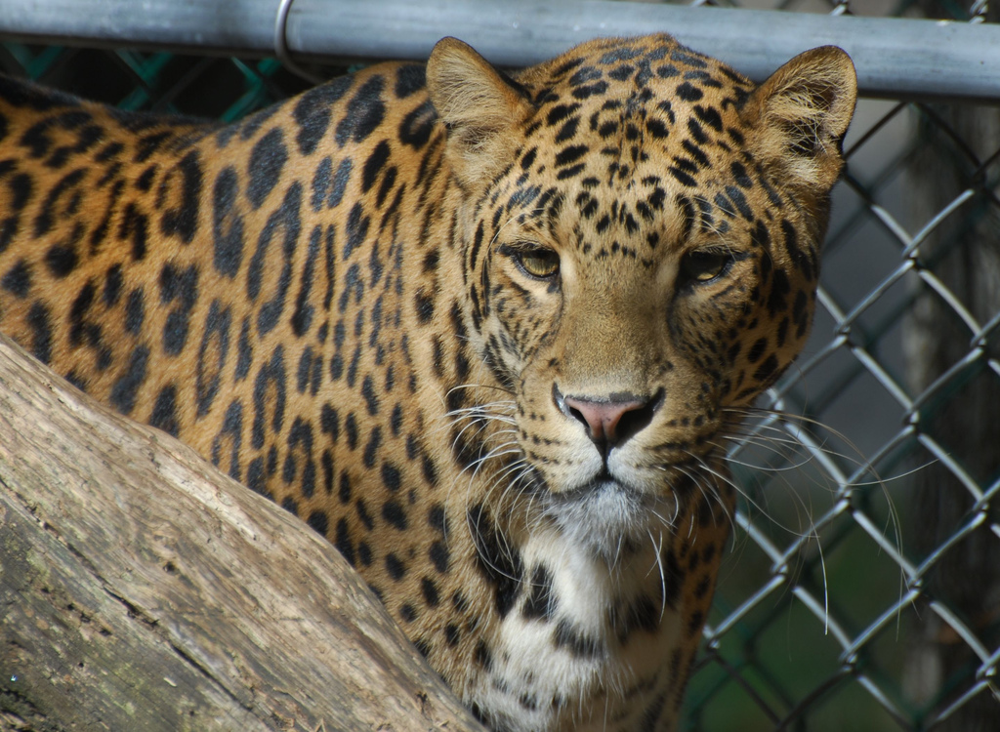

In [82]:
img=Image.open("./leopard_10001.jpg")
img

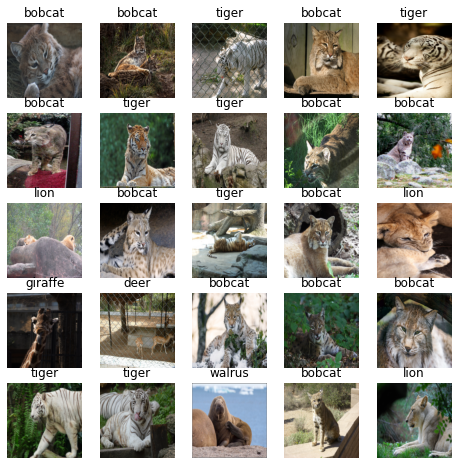

In [83]:
img=img.resize(size=(200,200))
pred_img=model(transform(img).unsqueeze(0).cuda())
idxs,dists = get_knn(nn_predwv, pred_img.cpu().detach().numpy())
names=show_preds(idxs)

In [84]:
l=[]
l=glove_vectors.most_similar(names,topn=5)
recommend= []
recommend.append(glove_vectors.most_similar(l[0][0],topn=5))

In [85]:
recommend

[[('bobcat', 0.5789191722869873),
  ('saget', 0.42118149995803833),
  ('smither', 0.40817543864250183),
  ('bogosian', 0.4080170691013336),
  ('sturken', 0.3985797166824341)]]

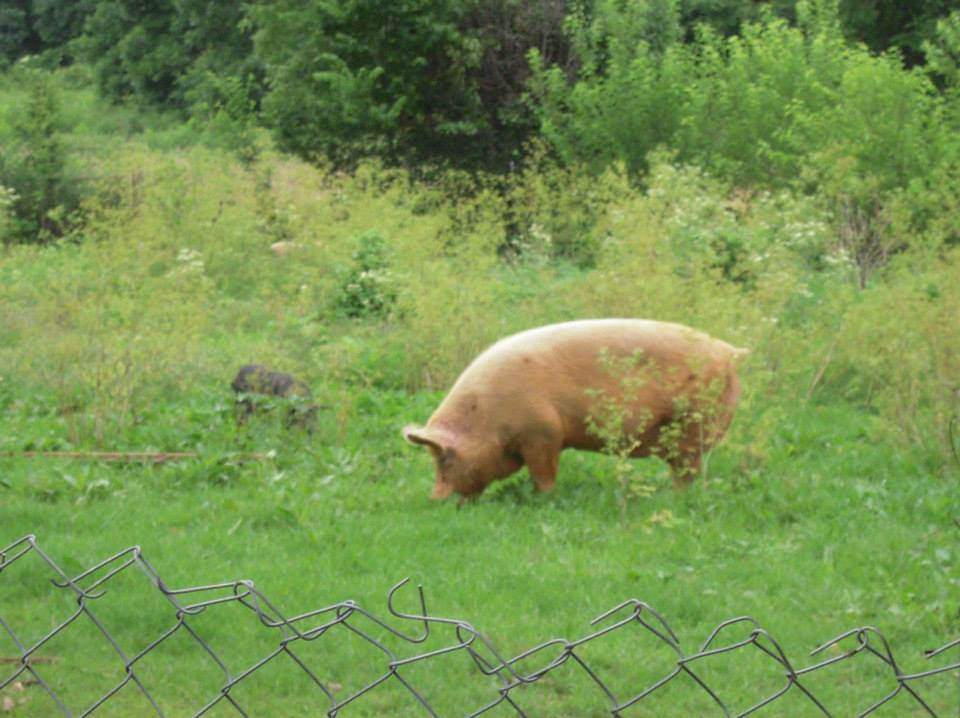

In [86]:
img=Image.open("./pig_10012.jpg")
img

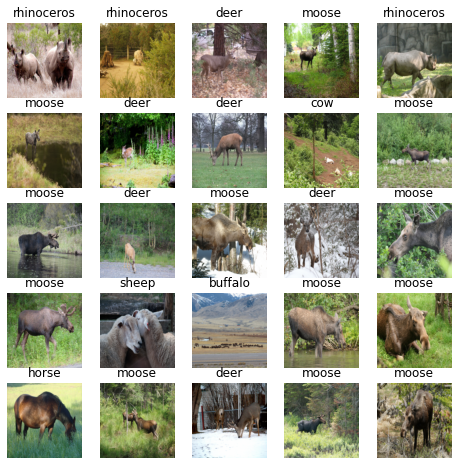

In [87]:
img=img.resize(size=(200,200))
pred_img=model(transform(img).unsqueeze(0).cuda())
idxs,dists = get_knn(nn_predwv, pred_img.cpu().detach().numpy())
names=show_preds(idxs)

In [88]:
l=[]
l=glove_vectors.most_similar(names,topn=5)
recommend= []
recommend.append(glove_vectors.most_similar(l[0][0],topn=5))

In [89]:
recommend

[[('elephants', 0.7349486947059631),
  ('rhinoceros', 0.6177136301994324),
  ('rhino', 0.6048589944839478),
  ('lion', 0.598197877407074),
  ('tusks', 0.5563178658485413)]]

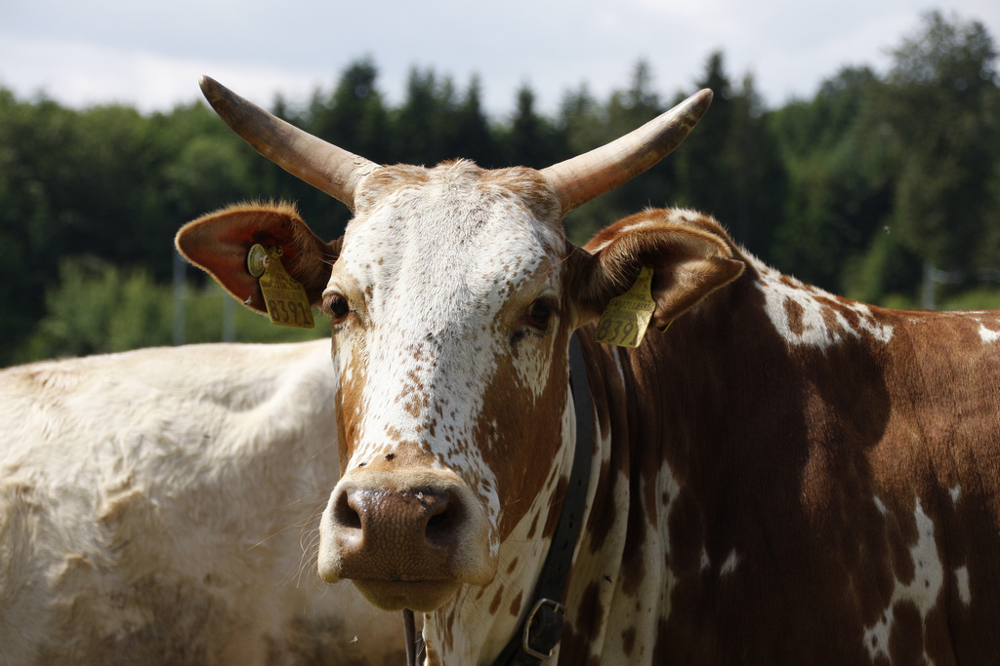

In [90]:
#Vali_data
img=Image.open("./ox_10043.jpg")
img

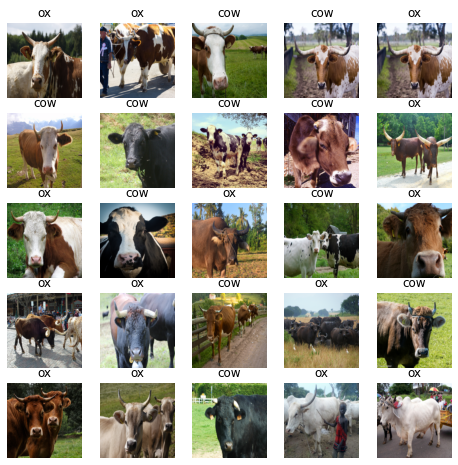

In [91]:
img=img.resize(size=(200,200))
pred_img=model(transform(img).unsqueeze(0).cuda())
idxs,dists = get_knn(nn_predwv, pred_img.cpu().detach().numpy())
names=show_preds(idxs)

In [92]:
l=[]
l=glove_vectors.most_similar(names,topn=5)
recommend= []
recommend.append(glove_vectors.most_similar(l[0][0],topn=5))

In [93]:
recommend

[[('donkeys', 0.6502612233161926),
  ('ox', 0.641258180141449),
  ('mules', 0.6090449094772339),
  ('camels', 0.6006430983543396),
  ('horses', 0.5487847924232483)]]

## Test data eval

In [94]:
print(test_classes)

['chimpanzee' 'hippopotamus' 'leopard' 'pig' 'raccoon' 'rat' 'seal']


In [95]:
test_nn_predwv = create_index(pred_test)

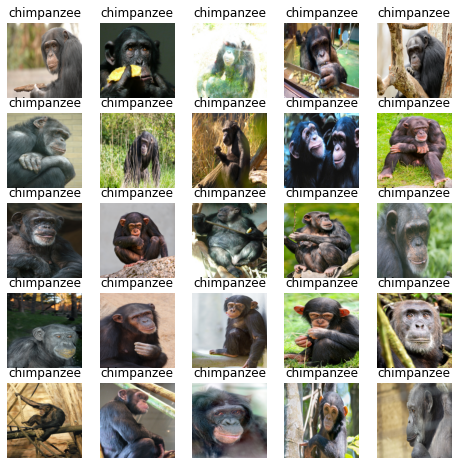

In [96]:
#vec = ft_model.wv['bear']
vec = glove_vectors.get_vector('chimpanzee')
idxs,dists = get_knn(test_nn_predwv, vec)
names=show_preds(idxs,dset="test")

In [97]:
l=[]
l=glove_vectors.most_similar(names,topn=5)
recommend= []
recommend.append(glove_vectors.most_similar(l[0][0],topn=5))
recommend

[[('chimpanzee', 0.7751608490943909),
  ('chimps', 0.547661304473877),
  ('chimpanzees', 0.5234294533729553),
  ('bonobo', 0.47701919078826904),
  ('gorilla', 0.4635811448097229)]]

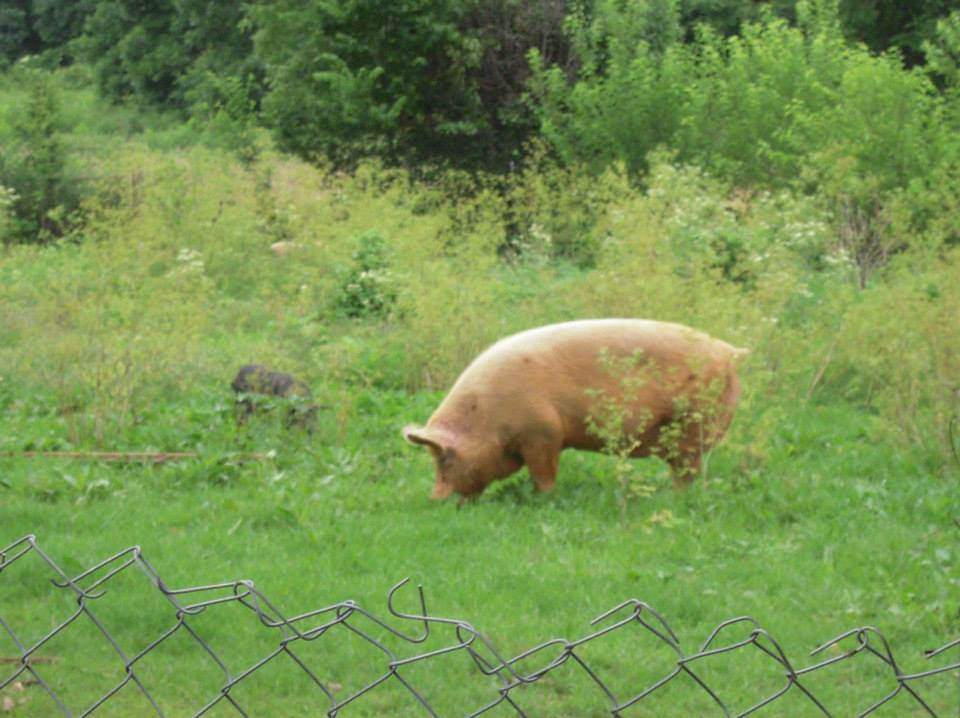

In [99]:
img=Image.open("./pig_10012.jpg")
img

'pig'

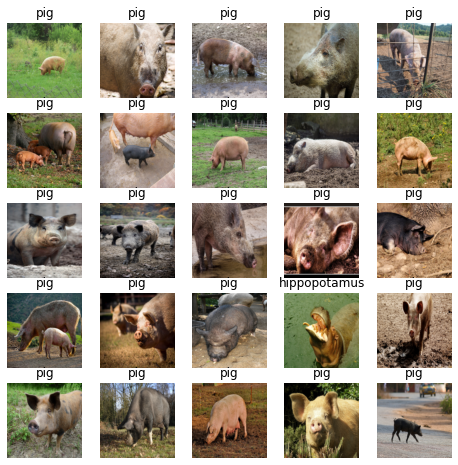

In [100]:
img=img.resize(size=(200,200))
pred_img=model(transform(img).unsqueeze(0).cuda())
idxs,dists = get_knn(test_nn_predwv, pred_img.cpu().detach().numpy())
names=show_preds(idxs,dset="test")
names

### Mix Data(Val+Test)

##### 製作Val+Test的Data，但也可以直接以現有的Val與Test做 Vstack。(concatenate)

In [101]:
Classes=[]
Images=[]
Img_vec=[]
Class_labels=[]
Images=np.load(load_path+'mix_img_name.npy',allow_pickle=True)
Img_vec=np.load(load_path+'mix_img_vec.npy',allow_pickle=True)
Classes=np.load(load_path+'mix_img_class.npy',allow_pickle=True)
Class_labels=np.load(load_path+'mix_img_label.npy',allow_pickle=True)

In [102]:
#Classes#Images#Img_vec
grouped= list(zip(Images, Img_vec,Class_labels)) 
random.shuffle(grouped) 
Images, Img_vec,Class_labels = zip(*grouped)

In [103]:
datasets = Dataset(Images,Img_vec,transform)

In [104]:
batch_size=64
mix_dl = DataLoader(datasets, batch_size*2, shuffle=False,drop_last=False, num_workers=0, pin_memory=True)

In [105]:
try:
    pred_train=np.load(load_path+'mix_attr_.npy',allow_pickle=True)
except IOError:
    mix_pred_wvs = predict_dl_batch(mix_dl,model)
    np.save(load_path+'mix_attr_.npy', mix_pred_wvs)

  0%|          | 0/78 [00:00<?, ?it/s]

In [106]:
print(mix_pred_wvs.shape)
Img_vec  = np.stack(Img_vec)
print(Img_vec.shape)

(9922, 200)
(9922, 200)


In [107]:
mix_nn_predwv = create_index(mix_pred_wvs)

C:\Users\User\anaconda3\envs\torch_37py\lib\site-packages\ipykernel_launcher.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  from ipykernel import kernelapp as app


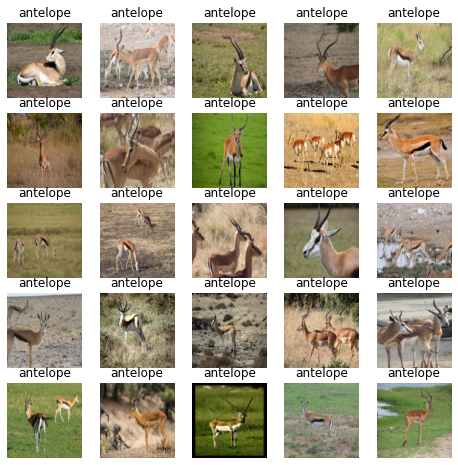

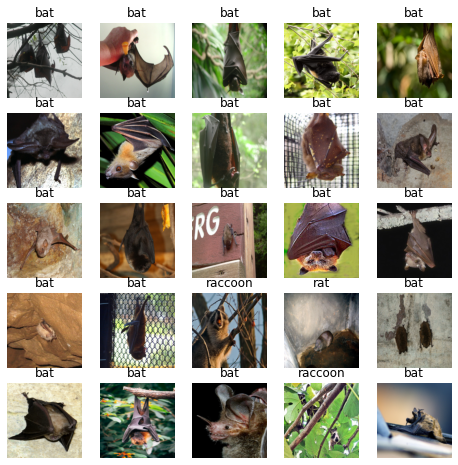

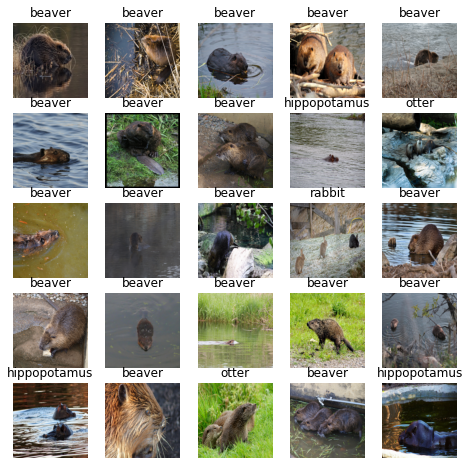

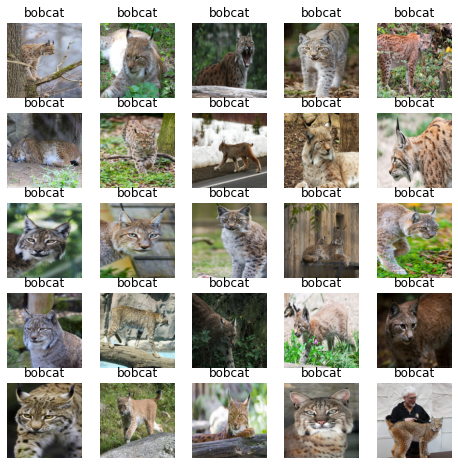

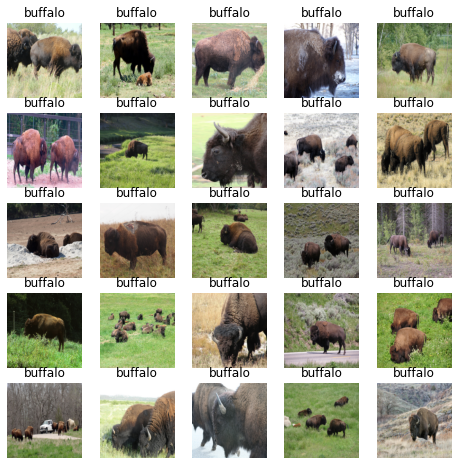

...

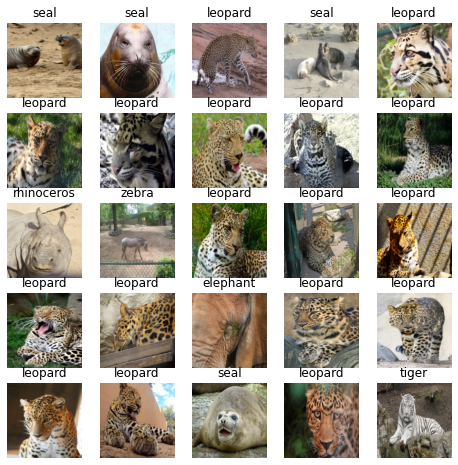

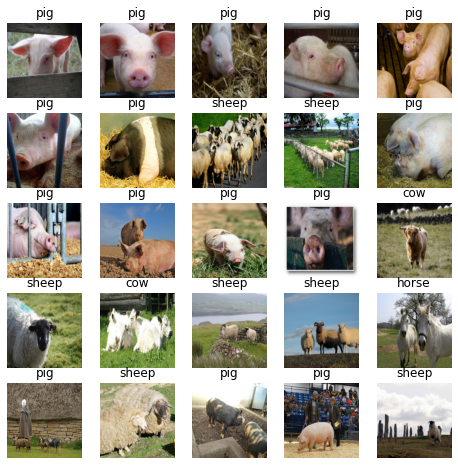

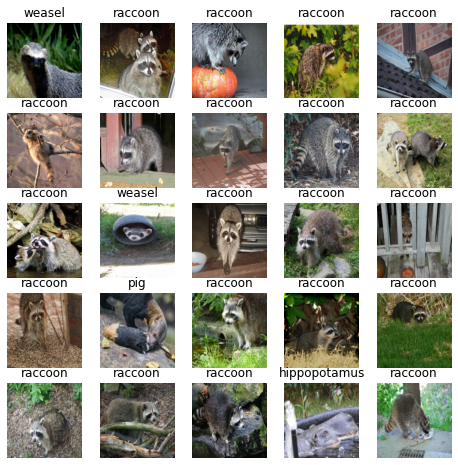

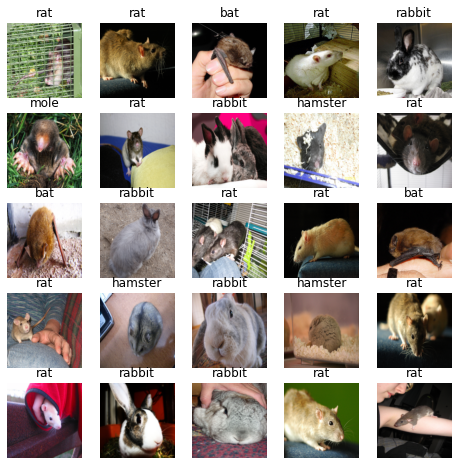

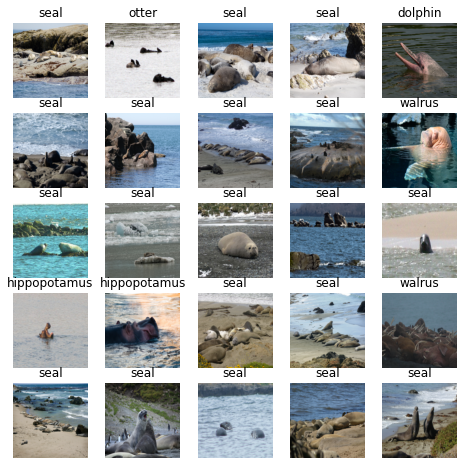

In [108]:
for i in range(len(Classes)):
    vec = glove_vectors.get_vector(Classes[i])
    idxs,dists = get_knn(mix_nn_predwv, vec)
    show_preds(idxs,"mix")

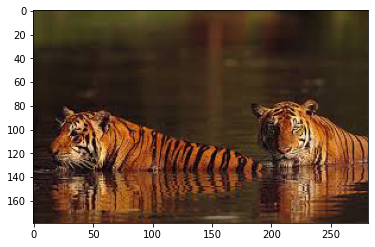

In [109]:
img=Image.open("./tiger4.jpg")
plt.imshow(img)
#img=img.resize(size=(200,200))
#pred_img=model(transform(img).unsqueeze(0).cuda())
#idxs,dists = get_knn(nn_predwv, pred_img.cpu().detach().numpy())
#names=show_preds(idxs)